## **Machine learning for vision and multimedia** @PoliTO

**Monocular Depth Estimation: a Transfer Learning approach**
Accurate depth estimation is crucial in various computer vision tasks related to scene understanding and image reconstruction. Depth estimation models have lately shown to be powerful tools when implemented in sensor-fusion frameworks applied to contexts involving mapping of unknown environments, in applications related to mobile robotics (SLAM) or autonomous vehicles. While the most common approaches involve processing of stereo images pairs, this project aims at developing a Convolutional Neural Network to produce estimated depth maps of scenes represented by single monocular images. The model exploits a simple encoder-decoder architecture with skip connections, where the encoder block is extracted from the backbone of a YOLOv8 pre-trained for instance segmentation tasks. This Transfer Learning approach exploits the powerful feature extraction capabilities of one of the best state-of-the-art models, allowing to obtain a small and simple architecture able to produce accurate results even if trained for short times and on a relatively small dataset such as NYUv2.

## **NYU Depth V2 Labeled Dataset download** (only if you are not running in a Kaggle Notebook)

Get Kaggle API tab  **! necessary in order to download dataset !**

In [1]:
from google.colab import files

! rm kaggle.json
! rm -rf ~/.kaggle

# Upload kaggle.json
files.upload()

! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

rm: cannot remove 'kaggle.json': No such file or directory


Saving kaggle.json to kaggle.json


Download dataset from Kaggle

In [2]:
! pip install kaggle
! kaggle datasets download -d soumikrakshit/nyu-depth-v2
! rm -rf nyu-depth-v2/
! unzip -q nyu-depth-v2.zip -d nyu-depth-v2 && rm nyu-depth-v2.zip

Dataset URL: https://www.kaggle.com/datasets/soumikrakshit/nyu-depth-v2
License(s): unknown
100% 4.10G/4.10G [01:04<00:00, 97.3MB/s]
100% 4.10G/4.10G [01:04<00:00, 68.7MB/s]


## **Import modules**

In [3]:
import torch
! pip install ultralytics
from ultralytics import YOLO
from PIL import Image
! pip install torchinfo
from torchinfo import summary
! pip install torchmetrics
import matplotlib.pyplot as plt
! pip install dill

import torch.nn as nn
import pandas as pd
from PIL import Image
from torch.utils.data import Dataset
import os
from torchvision.io import read_image
from torchvision import transforms
from torchvision.transforms import v2 as transformsv2
from torch.utils.data import random_split
import random
import torch.nn.functional as F

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 kB 7.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-many

## **Dataset class**

In [4]:
import numpy as np

class NYU_Depth_v2(Dataset):
    def __init__(self, path_csv, size_height,
                 image_base_transform=None,
                 label_base_transform=None,
                 transform_prob=None):
        self.path_csv = path_csv
        data_folder = os.path.dirname(self.path_csv)
        self.base_path = os.path.dirname(data_folder)
        self.paths = pd.read_csv(self.path_csv)
        self.size_height = size_height
        self.image_base_transform = image_base_transform
        self.label_base_transform = label_base_transform
        self.transform_prob = transform_prob

    def __len__(self):
        return len(self.paths)

    def __getitem__(self, idx):
        path_row = self.paths.iloc[idx]
        img_path = os.path.join(self.base_path,path_row.iloc[0])
        label_path = os.path.join(self.base_path,path_row.iloc[1])
        image = Image.open(img_path)
        label = Image.open(label_path)
        if self.image_base_transform:
            image = self.image_base_transform(image)
        if self.label_base_transform:
            label = self.label_base_transform(label)
        if self.transform_prob:
            for t, p in self.transform_prob:
                if torch.rand(1) > p:
                    image = t(image)
                    label = t(label)
        return image, label

    def get_no_transform(self, idx):
        path_row = self.paths.iloc[idx]
        img_path = os.path.join(self.base_path,path_row.iloc[0])
        label_path = os.path.join(self.base_path,path_row.iloc[1])
        image = Image.open(img_path)
        label = Image.open(label_path)
        resize = transforms.Resize(self.size_height)
        return resize(image), resize(label)

## **Train and validation data loaders**

In [5]:
batch_size = 32
height_size = 240

def label_resize(label):
    maxv = label.max()
    minv = label.min()
    newmax = 1
    newmin = 0
    return ((label-minv)/(maxv-minv)) * (newmax-newmin) + newmin

img_base_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(height_size, antialias=False)
    ])

label_base_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(int(height_size/2), antialias=False),
    #transforms.Resize(height_size, antialias=False),
    transforms.Lambda(lambda x: label_resize(x))
    ])

label_base_transform_test = transforms.Compose([
    transforms.ToTensor(),
    #transforms.Resize(int(height_size/2), antialias=False),
    transforms.Resize(height_size, antialias=False),
    #transforms.Lambda(lambda x: label_resize(x))
    ])

# pairs of transform and its probability
transforms_prob = [
    (transforms.RandomHorizontalFlip(1), 0.5),
    (transformsv2.RandomChannelPermutation(), 0.25)
    ]

Split train and validation set

In [6]:
csv_train = "nyu_data/data/nyu2_train.csv"
csv_test = "nyu_data/data/nyu2_test.csv"

# Detect if you are using kaggle and set import path accordingly
if 'KAGGLE_KERNEL_RUN_TYPE' in os.environ:
    base_path = "/kaggle/input/nyu-depth-v2/"
else:
    base_path = "/content/nyu-depth-v2/"

csv_train = os.path.join(base_path,csv_train)
csv_test = os.path.join(base_path,csv_test)

dataset_train = NYU_Depth_v2(path_csv=csv_train,
                             size_height=height_size,
                             image_base_transform=img_base_transform,
                             label_base_transform=label_base_transform,
                             transform_prob=transforms_prob)
dataset_test = NYU_Depth_v2(path_csv=csv_test,
                            size_height=height_size,
                            image_base_transform=img_base_transform,
                            label_base_transform=label_base_transform_test)

train_size = int(0.9*len(dataset_train))
val_size = int((len(dataset_train) - train_size))

train_split, val_split, overfit_split = random_split(dataset_train, [train_size-batch_size, val_size, batch_size])

Instantiate data loaders

In [7]:
num_workers = 4

train_loader = torch.utils.data.DataLoader(dataset = train_split, batch_size = batch_size,shuffle = True, pin_memory=True, num_workers=num_workers)
val_loader = torch.utils.data.DataLoader(dataset = val_split, batch_size = batch_size,shuffle = True, pin_memory=True, num_workers=num_workers)
test_loader = torch.utils.data.DataLoader(dataset = dataset_test, batch_size = batch_size,shuffle = True, pin_memory=True, num_workers=num_workers)
test_overfit_loader = torch.utils.data.DataLoader(dataset = overfit_split, batch_size = 8,shuffle = True, pin_memory=True, num_workers=num_workers)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [8]:
print(len(train_loader.dataset),len(train_loader))
print(len(val_loader.dataset), len(val_loader))
print(len(test_loader.dataset), len(test_loader))
print(len(test_overfit_loader.dataset), len(test_overfit_loader))

img, depthmap = dataset_test[random.randint(0,len(dataset_test)-1)]

imgsize = img.shape
labelsize = depthmap.shape

print('Image size ', imgsize)
print('Label size ', labelsize)

45586 1425
5069 159
653 21
32 4
Image size  torch.Size([3, 240, 320])
Label size  torch.Size([1, 240, 320])


## **Inspection on dataset**

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


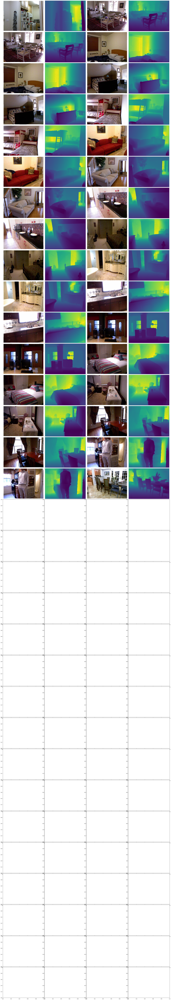

In [9]:
from skimage import img_as_float

for batch in test_loader:
    sample_batch = batch
    break

fig, axs = plt.subplots(len(sample_batch[0]), 4, figsize=(32,6*len(sample_batch[0])))
plt.subplots_adjust(hspace=0.02)
plt.subplots_adjust(wspace=0.01)

for i in range(int(len(sample_batch[0])/2)):
    img_tensor = sample_batch[0][i]
    label = sample_batch[1][i]
    img = transforms.functional.to_pil_image(img_tensor)
    depthmap = transforms.functional.to_pil_image(label)
    axs[i][0].imshow(img)
    axs[i,0].axis('off')
    axs[i][1].imshow(img_as_float(depthmap))
    axs[i,1].axis('off')
    i+=1
    img_tensor = sample_batch[0][i]
    label = sample_batch[1][i]
    img = transforms.functional.to_pil_image(img_tensor)
    depthmap = transforms.functional.to_pil_image(label)
    axs[i-1][2].imshow(img)
    axs[i-1,2].axis('off')
    axs[i-1][3].imshow(img_as_float(depthmap))
    axs[i-1,3].axis('off')


fig.savefig('dataset.png')
maximg = torch.max(img_tensor)
minimg = torch.min(img_tensor)

maxlabel = torch.max(label)
minlabel = torch.min(label)

#print(f"IMAGE Max:{maximg} Min:{minimg}")
#print(f"LABEL Max:{maxlabel} Min:{minlabel}")
#print(label)

Colouring depth maps TO BE MODIFIED AND TESTED

## **Model definition**

Check if we have GPU

In [10]:
if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
print(device)

cuda


Extract YOLO backbone

In [11]:
yolo = YOLO("yolov8n-seg.pt")
yolo_backbone = nn.Sequential(*(list(list(yolo.named_modules())[2][1].children())[:10]))
yolo_backbone.to(device)

summary(yolo_backbone, input_size=(1, 3, imgsize[1], imgsize[2]))
#summary(yolo_backbone)

100%|██████████| 6.73M/6.73M [00:00<00:00, 112MB/s]


Layer (type:depth-idx)                        Output Shape              Param #
Sequential                                    [1, 256, 8, 10]           --
├─Conv: 1-1                                   [1, 16, 120, 160]         --
│    └─Conv2d: 2-1                            [1, 16, 120, 160]         (432)
│    └─BatchNorm2d: 2-2                       [1, 16, 120, 160]         (32)
├─SPPF: 1-50                                  --                        (recursive)
│    └─Conv: 2-57                             --                        (recursive)
│    │    └─SiLU: 3-1                         [1, 16, 120, 160]         --
├─Conv: 1-3                                   [1, 32, 60, 80]           --
│    └─Conv2d: 2-4                            [1, 32, 60, 80]           (4,608)
│    └─BatchNorm2d: 2-5                       [1, 32, 60, 80]           (64)
├─SPPF: 1-50                                  --                        (recursive)
│    └─Conv: 2-57                             --        

Extract DenseNet backbone

In [12]:
from torchvision import models

densenet = models.densenet169(pretrained=True)
densenet_backbone = nn.Sequential(*list(densenet.children())[:-1])
densenet_backbone.to(device)

summary(densenet_backbone, input_size=(1, 3, imgsize[1], imgsize[2]))

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet169_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet169_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet169-b2777c0a.pth" to /root/.cache/torch/hub/checkpoints/densenet169-b2777c0a.pth
100%|██████████| 54.7M/54.7M [00:00<00:00, 83.4MB/s]


Layer (type:depth-idx)                   Output Shape              Param #
Sequential                               [1, 1664, 7, 10]          --
├─Sequential: 1-1                        [1, 1664, 7, 10]          --
│    └─Conv2d: 2-1                       [1, 64, 120, 160]         9,408
│    └─BatchNorm2d: 2-2                  [1, 64, 120, 160]         128
│    └─ReLU: 2-3                         [1, 64, 120, 160]         --
│    └─MaxPool2d: 2-4                    [1, 64, 60, 80]           --
│    └─_DenseBlock: 2-5                  [1, 256, 60, 80]          --
│    │    └─_DenseLayer: 3-1             [1, 32, 60, 80]           45,440
│    │    └─_DenseLayer: 3-2             [1, 32, 60, 80]           49,600
│    │    └─_DenseLayer: 3-3             [1, 32, 60, 80]           53,760
│    │    └─_DenseLayer: 3-4             [1, 32, 60, 80]           57,920
│    │    └─_DenseLayer: 3-5             [1, 32, 60, 80]           62,080
│    │    └─_DenseLayer: 3-6             [1, 32, 60, 80]     

Test extracted backbones

In [13]:
input_tensor = torch.randn(1, 3, imgsize[1], imgsize[2])
print("Input size: ", input_tensor.shape)
result = yolo_backbone(input_tensor.to(device))
print("YOLO backbone output size: ", result.shape)
yolo_encoder_features = result.shape[1]
result = densenet_backbone(input_tensor.to(device))
print("DenseNet backbone output size: ", result.shape)
densenet_encoder_features = result.shape[1]

Input size:  torch.Size([1, 3, 240, 320])
YOLO backbone output size:  torch.Size([1, 256, 8, 10])
DenseNet backbone output size:  torch.Size([1, 1664, 7, 10])


## **YOLO - backbone model, no skip connections**

In [14]:
class UpSamplenoskip(nn.Module):
    def __init__(self, input_channels, output_channels, scale=2):
        super(UpSamplenoskip, self).__init__()
        self.upsample = nn.Upsample(scale_factor=scale, mode='bilinear', align_corners=True)
        self.conv1 = nn.Conv2d(input_channels, output_channels*2, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(output_channels*2, output_channels, kernel_size=3, stride=1, padding=1)
    def forward(self, x):
        x = self.upsample(x)
        x = self.conv1(x)
        return self.conv2(x)

class Decoder(nn.Module):
    def __init__(self, encoder_channels = yolo_encoder_features, output_channels=1):
        super(Decoder, self).__init__()
        #1x1 conv of output layer of the encoder
        self.conv = nn.Conv2d(encoder_channels,encoder_channels,kernel_size=1,stride=1,padding=0)
        self.up1 = UpSamplenoskip(encoder_channels, encoder_channels//2)
        self.lrelu1 = nn.LeakyReLU(0.02)
        self.up2 = UpSamplenoskip(encoder_channels//2, encoder_channels//4)
        self.lrelu2 = nn.LeakyReLU(0.02)
        self.up3 = UpSamplenoskip(encoder_channels//4, encoder_channels//8)
        self.lrelu3 = nn.LeakyReLU(0.02)
        self.up4 = UpSamplenoskip(encoder_channels//8, encoder_channels//16)
        # removed if size is 240x320
        #self.up5 = UpSample(encoder_channels//16, encoder_channels//32)
        #self.conv = nn.Conv2d(encoder_channels//32,output_channels,kernel_size=3,stride=1,padding=1)
        self.conv = nn.Conv2d(encoder_channels//16,output_channels,kernel_size=3,stride=1,padding=1)

    def forward(self, x):
        x = self.up1(x)
        x = self.lrelu1(x)
        x = self.up2(x)
        x = self.lrelu2(x)
        x = self.up3(x)
        x = self.lrelu3(x)
        x = self.up4(x)
        x = F.interpolate(x, size=[imgsize[1], imgsize[2]], mode='bilinear', align_corners=True)
        #x = self.up5(x)
        return self.conv(x)

class ModelYOLOnoskip(nn.Module):
    def __init__(self):
        super (ModelYOLOnoskip, self).__init__()
        self.encoder = yolo_backbone
        self.decoder = Decoder()

    def forward(self, x):
        return self.decoder(self.encoder(x))

## UpSample block

In [15]:
class UpSample(nn.Sequential):
    def __init__(self, skip_input, output_features):
        super(UpSample, self).__init__()
        self.convA = nn.Conv2d(skip_input, output_features, kernel_size=3, stride=1, padding=1)
        self.leakyreluA = nn.LeakyReLU(0.2)
        self.convB = nn.Conv2d(output_features, output_features, kernel_size=3, stride=1, padding=1)
        self.leakyreluB = nn.LeakyReLU(0.2)

    def forward(self, x, concat_with):
        up_x = F.interpolate(x, size=[concat_with.size(2), concat_with.size(3)], mode='bilinear', align_corners=True)
        return self.leakyreluB( self.convB( self.leakyreluA(self.convA( torch.cat([up_x, concat_with], dim=1) ) ) )  )

## **Complete YOLO backbone model**

In [16]:
class DecoderYOLO(nn.Module):
    def __init__(self, num_features=512, decoder_width = 1):
        super(DecoderYOLO, self).__init__()
        features = int(num_features * decoder_width)

        self.conv1 = nn.Conv2d(num_features, features, kernel_size=1, stride=1, padding=1)

        self.up1 = UpSample(skip_input=features//1 + 128, output_features=features//2)
        self.up2 = UpSample(skip_input=features//2 + 64, output_features=features//4)
        self.up3 = UpSample(skip_input=features//4 +  32, output_features=features//8)
        self.up4 = UpSample(skip_input=features//8 +  16, output_features=features//16)

        self.conv2 = nn.Conv2d(features//16, 1, kernel_size=3, stride=1, padding=1)

    def forward(self, features):
        x_block0, x_block1, x_block2, x_block3, x_block4 = features[1], features[3], features[5], features[7], features[9]
        x_d0 = self.conv1(x_block4)
        x_d1 = self.up1(x_d0, x_block3)
        x_d2 = self.up2(x_d1, x_block2)
        x_d3 = self.up3(x_d2, x_block1)
        x_d4 = self.up4(x_d3, x_block0)
        out = self.conv2(x_d4)
        return torch.clamp(out,min=0,max=1)

class EncoderYOLO(nn.Module):
    def __init__(self):
        super(EncoderYOLO, self).__init__()
        self.backbone = yolo_backbone

    def forward(self, x):
        features = [x]
        for v in yolo_backbone:
            features.append( v(features[-1]) )
        return features

class ModelYOLO(nn.Module):
    def __init__(self):
        super(ModelYOLO, self).__init__()
        self.encoder = EncoderYOLO()
        self.decoder = DecoderYOLO(num_features=yolo_encoder_features)

    def forward(self, x):
        return self.decoder( self.encoder(x) )

## **DenseNet backbone model**

In [17]:
class DecoderDenseNet(nn.Module):
    def __init__(self, num_features=2208, decoder_width = 0.5):
        super(DecoderDenseNet, self).__init__()
        features = int(num_features * decoder_width)

        self.conv2 = nn.Conv2d(num_features, features, kernel_size=1, stride=1, padding=1)

        #self.up1 = UpSample(skip_input=features//1 + 384, output_features=features//2)
        #self.up2 = UpSample(skip_input=features//2 + 192, output_features=features//4)
        #self.up3 = UpSample(skip_input=features//4 +  96, output_features=features//8)
        #self.up4 = UpSample(skip_input=features//8 +  96, output_features=features//16)

        self.up1 = UpSample(skip_input=features//1 + 256, output_features=features//2)
        self.up2 = UpSample(skip_input=features//2 + 128, output_features=features//4)
        self.up3 = UpSample(skip_input=features//4 +  64, output_features=features//8)
        self.up4 = UpSample(skip_input=features//8 +  64, output_features=features//16)

        self.conv3 = nn.Conv2d(features//16, 1, kernel_size=3, stride=1, padding=1)

    def forward(self, features):
        x_block0, x_block1, x_block2, x_block3, x_block4 = features[3], features[4], features[6], features[8], features[11]
        x_d0 = self.conv2(x_block4)
        x_d1 = self.up1(x_d0, x_block3)
        x_d2 = self.up2(x_d1, x_block2)
        x_d3 = self.up3(x_d2, x_block1)
        x_d4 = self.up4(x_d3, x_block0)
        return self.conv3(x_d4)

class EncoderDenseNet(nn.Module):
    def __init__(self):
        super(EncoderDenseNet, self).__init__()
        self.original_model = densenet

    def forward(self, x):
        features = [x]
        for k, v in self.original_model.features._modules.items():
            features.append( v(features[-1]) )
        return features

class ModelDense(nn.Module):
    def __init__(self):
        super(ModelDense, self).__init__()
        self.encoder = EncoderDenseNet()
        self.decoder = DecoderDenseNet(num_features = densenet_encoder_features)

    def forward(self, x):
        return self.decoder( self.encoder(x) )

## **Define model and check it works**

In [18]:
depthestimation = ModelYOLO()

input_tensor = torch.randn(1, 3, imgsize[1], imgsize[2])
print("Input size: ", input_tensor.shape)

depthestimation.to(device)
result = depthestimation(input_tensor.to(device))

print("Output size: ", result.shape)

Input size:  torch.Size([1, 3, 240, 320])
Output size:  torch.Size([1, 1, 120, 160])


## **Training**

Loss function definition

In [19]:
from torchmetrics.functional.image import structural_similarity_index_measure as ssim

def L1dist(ypred, y):
    L = torch.mean(abs(y - ypred))
    return L

def Lgrad(ypred, y):
    dx_y = torch.mean(torch.abs(y[:,:,:,1:] - y[:,:,:,:-1]))
    dy_y = torch.mean(torch.abs(y[:,:,1:,:] - y[:,:,:-1,:]))
    dx_ypred = torch.mean(torch.abs(ypred[:,:,:,1:] - ypred[:,:,:,:-1]))
    dy_ypred = torch.mean(torch.abs(ypred[:,:,1:,:] - ypred[:,:,:-1,:]))
    L = abs(dx_y - dx_ypred) + abs(dy_y - dy_ypred)

    return L

def LSSIM(ypred, y):
    L = (1 - ssim(ypred,y))
    return L

class DepthEstimationLoss(nn.Module):
    def __init__(self, L1w=0.6, Lgw=0.9, LSw=0.85):
        super(DepthEstimationLoss, self).__init__()
        self.L1w = L1w
        self.Lgw = Lgw
        self.LSw = LSw

    def forward(self, ypred, y):
        L1 = L1dist(ypred,y)
        Lg = Lgrad(ypred,y)
        LS = LSSIM(ypred,y)

        L1 = self.L1w*L1
        Lg = self.Lgw*Lg
        LS = self.LSw*LS

        Ltot = L1 + Lg + LS
        return  Ltot, L1, Lg, LS

Save and load model functions

In [20]:
def save_checkpoint(model, filename, optimizer, training_losses, validation_losses, epochs, elapsed_time):
    ##print("The state dict keys: \n\n", model.state_dict().keys())
    checkpoint = {'model': ModelYOLO(),
                    'state_dict': model.state_dict(),
                    'optimizer' : optimizer.state_dict(),
                    'training_losses': training_losses,
                    'validation_losses': validation_losses,
                    'elapsed_epochs': epochs,
                    'elapsed_time': elapsed_time}
    torch.save(checkpoint, filename)

def load_checkpoint(checkpoint, optimizer):
    model = checkpoint['model']
    model.load_state_dict(checkpoint['state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer'])
    training_losses = checkpoint['training_losses']
    validation_losses = checkpoint['validation_losses']
    epochs = checkpoint['elapsed_epochs']
    elapsed_time = checkpoint['elapsed_time']
    model.to(device)

    return model, training_losses, validation_losses, epochs, elapsed_time

Train function definition

In [21]:
#! pip install tqdm
from tqdm import tqdm

def train(model, optimizer, loss_fn, train_loader, val_loader, total_epochs, filename_checkpoint, device=device, checkpoint=None):
    if (checkpoint != None):
        model, training_loss, validation_loss, epoch_init, elapsed_time = load_checkpoint(checkpoint, optimizer)
        #total_epochs = total_epochs - epochs
    else:
        training_loss = []
        validation_loss = []
        elapsed_time = 0
        epoch_init = 0


    start = torch.cuda.Event(enable_timing=True)
    end = torch.cuda.Event(enable_timing=True)
    torch.cuda.synchronize()
    start.record()
    for epoch in range(epoch_init,total_epochs):
        batch = 0
        progress_bar = tqdm(total=len(train_loader), desc=f'Epoch n. {epoch+1}', position=0, leave=True)
        train_loss = 0.0
        L1 = 0
        Lg = 0
        LS = 0
        valid_loss = 0.0
        model.train()

        load_time = 0
        train_time = 0
        loss_time = 0

        for batch in train_loader:
            progress_bar.update(1)

            optimizer.zero_grad()
            inputs, targets = batch
            inputs = inputs.to(device)
            targets = targets.to(device)
            output = model(inputs)

            Ltot, l1, lg, lS = loss_fn(output, targets)

            Ltot.backward()
            optimizer.step()
            train_loss += Ltot.data.item() * batch_size
            L1 += l1
            Lg += lg
            LS += lS

        train_loss /= len(train_loader.dataset)
        L1 /= len(train_loader.dataset)
        Lg /= len(train_loader.dataset)
        LS /= len(train_loader.dataset)

        model.eval()
        for batch in val_loader:
            inputs, targets = batch
            inputs = inputs.to(device)
            output = model(inputs)
            targets = targets.to(device)
            Ltot, _, _, _ = loss_fn(output, targets)
            valid_loss += Ltot.data.item() * batch_size

        valid_loss /= len(val_loader.dataset)

        print(f"\nEpoch: {epoch+1}, Training Loss: {train_loss:.6f}, Validation Loss: {valid_loss:.6f}")
        print(f"\t-- Training Loss components -- \n\tL1: {L1:.6f} \n\tLg: {Lg:.6f} \n\tLS: {LS:.6f}")
        #print(f"\tLoad time: {(load_time/tot_time)*100:0.2f}% Train time {(train_time/tot_time)*100:0.2f}% Loss time {(loss_time/tot_time)*100:0.2f}%")
        #print(f"\t-- Loss time components -- \n\tT1: {(T1/Ttot)*100:0.2f}% \n\tTg: {(Tg/Ttot)*100:0.2f}% \n\tTS: {(TS/Ttot)*100:0.2f}%")

        training_loss.append(train_loss)
        validation_loss.append(valid_loss)

        end.record()
        torch.cuda.synchronize()
        elapsed_time += start.elapsed_time(end)
        start.record()

        save_checkpoint(model, filename_checkpoint, optimizer, training_loss, validation_loss, epoch+1, elapsed_time)

    return training_loss, validation_loss, elapsed_time;

In [22]:
import torch.optim as optim
import dill
import datetime

learningrate = 0.0001
L1w=0.1
Lgw=1
LSw=1

device='cuda'
model = depthestimation.to(device)
model.train()
torch.compile(model)
optimizer = optim.Adam(params = model.parameters(),lr= learningrate)
criterion = DepthEstimationLoss(L1w=L1w, Lgw=Lgw, LSw=LSw)

filename_checkpoint = f"Model_YOLO_complete_checkpoint.pt"
resume_training = True
if resume_training:
    checkpoint = torch.load(filename_checkpoint, pickle_module=dill)
else:
    checkpoint = None

#### STANDARD TRAINING
total_epochs = 200;
training_loss, validation_loss, total_time = train(model, optimizer, criterion, train_loader, val_loader, total_epochs, filename_checkpoint, device=device, checkpoint=checkpoint)

#### TEST OVERFIT
# Set batch size to 8
#epochs = 6000
#training_loss, validation_loss, total_time = train(model, filename_checkpoint, optimizer, criterion, test_overfit_loader, test_overfit_loader, epochs, device=device)

print('Training losses\n')
print(training_loss)
print('\nValidation_losses\n')
print(validation_loss)
print(f'\nTotal time:{str(datetime.timedelta(total_time/1000))}')

Training losses

[0.37029970125804135, 0.3225949761301942, 0.30499533161756964, 0.29220127564621323, 0.28244239536168747, 0.2742116833164113, 0.2680427993692741, 0.2630064998541019, 0.2584056453309858, 0.2540646517035657, 0.2505092279743574, 0.24692858108038837, 0.24396866013177088, 0.24164793150675898, 0.23912098188814074, 0.2368399959865127, 0.23474508612590952, 0.23288726662290324, 0.23116590364481532, 0.22945050322323826, 0.2278460470951127, 0.2261712347875905, 0.22520310812959213, 0.22348716728350365, 0.2223828116405927, 0.22133662896990405, 0.2203034060273233, 0.21913119205097786, 0.21812543805002335, 0.21671845202374226, 0.21623559614839338, 0.21554217114505242, 0.21451909725241258, 0.21349055199176878, 0.21293855798159225, 0.2121306995183814, 0.2113721333145023, 0.21060570124310388, 0.20986967386371166, 0.20917356816023486, 0.20844317569355264, 0.20745597435676716, 0.2073805446095053, 0.2064120717513704, 0.20607498076728484, 0.20535428719727053, 0.2048880070250486, 0.2044097168

**Load model**

In [23]:
import dill
import torch.optim as optim

learningrate = 0.0001
model = depthestimation.to(device)
model.train()
torch.compile(model)
optimizer = optim.Adam(params = model.parameters(),lr= learningrate)

filename_checkpoint = f"Model_YOLO_complete_checkpoint.pt"
checkpoint = torch.load(filename_checkpoint, pickle_module=dill)
model, training_loss, validation_loss, total_epochs, elapsed_time = load_checkpoint(checkpoint, optimizer)

h, m = divmod(int(elapsed_time/60000),60)
print(f"Checkpoint loaded:\nElapsed epochs: {total_epochs}\nElapsed time: {h}h:{m}m\nLast training loss: {training_loss[-1]}\nLast validation loss: {validation_loss[-1]}\n")

Checkpoint loaded:
Elapsed epochs: 200
Elapsed time: 16h:29m
Last training loss: 0.1873985480253847
Last validation loss: 0.18919786595103538



Plot training and validation losses

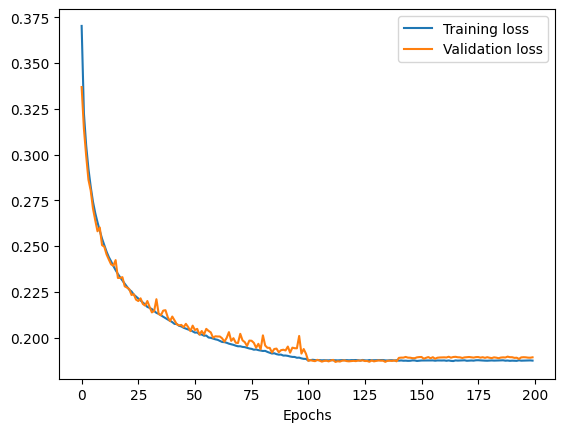

In [24]:
plt.plot(range(total_epochs), training_loss, label='Training loss')
plt.plot(range(total_epochs), validation_loss, label='Validation loss')
plt.xlabel("Epochs")
#plt.ylabel("Loss value")
plt.legend(loc="upper right")
plt.savefig(f'losses_bs{batch_size}_eps{total_epochs}.png')

## **TEST OVERFIT**

Plot image - prediction - groundtruth

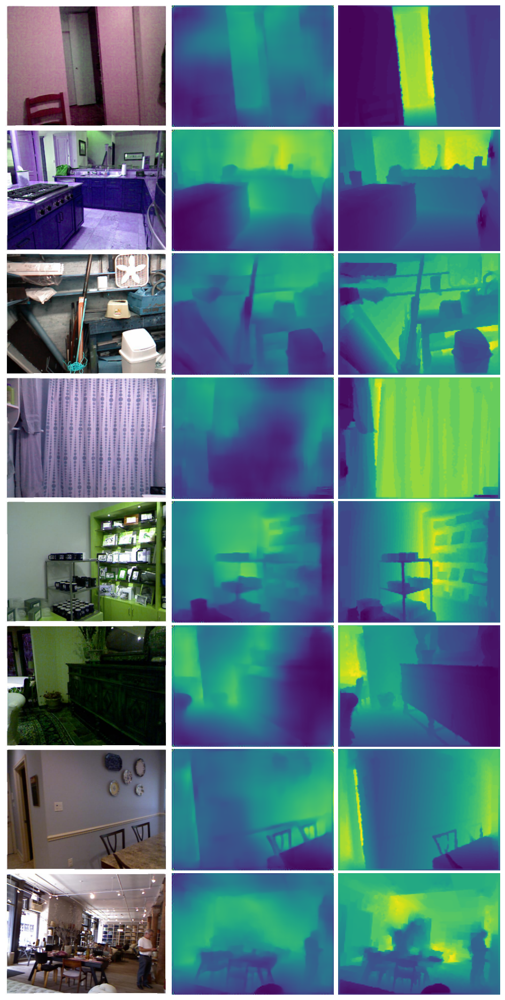

In [25]:
for batch in test_overfit_loader:
    sample_batch = batch

fig, axs = plt.subplots(len(sample_batch[0]), 3, figsize=(12,3*len(sample_batch[0])))
plt.subplots_adjust(hspace=0.02)
plt.subplots_adjust(wspace=0.01)

for i in range(int(len(sample_batch[0]))):
    img_tensor = sample_batch[0][i]
    label = sample_batch[1][i]
    img = transforms.functional.to_pil_image(img_tensor)
    depthmap = transforms.functional.to_pil_image(label)
    img_tensor.to(device)
    label.to(device)
    #yolo.to(device)
    #dense.to(device)

    results = model(img_tensor.view(1,img_tensor.shape[0],img_tensor.shape[1],img_tensor.shape[2]).to(device))
    res = results[0]
    printres = res.view(res.shape[1], res.shape[2])

    #Ltot, L1, Lg, LS  = DepthEstimationLoss().forward(res.view(1,1,res.shape[1],res.shape[2]).to(device),label.view(1,1,label.shape[1],label.shape[2]).to(device))
    #print(f"L1dist: {L1} Lgrad: {Lg} LSSIM: {LS} -- Ltot: {Ltot}")

    img = transforms.functional.to_pil_image(img_tensor)
    depthmap = transforms.functional.to_pil_image(label)
    axs[i][0].imshow(img)
    axs[i][1].imshow(img_as_float(printres.cpu().detach().numpy()))
    axs[i][2].imshow(img_as_float(depthmap))
    axs[i,0].axis('off')
    axs[i,1].axis('off')
    axs[i,2].axis('off')

#fig.savefig('yolo_complete.png')

## **TEST COMPLETE MODEL**

Performance metrics

In [36]:
def rel(ypred, y):
    return torch.mean(torch.abs(y-ypred))

def rms(ypred, y):
    return torch.sqrt(torch.mean((y-ypred)*(y-ypred)))

def log(ypred, y):
    l1 = torch.log10(y+1)
    l2 = torch.log10(ypred+1)
    #print(f"log10(y): {l1}   log10(ypred): {l2}")
    return abs(torch.mean(l1-l2))

Plot image - prediction - groundtruth

In [ ]:
rel_tot = 0
rms_tot = 0
log_tot = 0

device = 'cuda'
model.eval()
model.to(device)
for batch in test_loader:
    inputs, targets = batch
    inputs = inputs.to(device)
    #inputsflip = transforms.functional.hflip(inputs)
    targets = targets.to(device)
    targets = targets/10000

    res = model(inputs)
    #resflip = model(inputsflip)
    #upscaling
    res = nn.functional.interpolate(res,scale_factor=2,mode='bilinear')
    #resflip = nn.functional.interpolate(resflip,scale_factor=2,mode='bilinear')
    #remove meaningless values due to wrong flat maps
    #res = torch.clamp(res,min=0.001,max=1)
    #make results comparable with reference paper
    #res = res*10000
    #res = (res + transforms.functional.hflip(resflip))/2
    sample_batch = batch
    rel_v = rel(res,targets)
    rms_v = rms(res,targets)
    log_v = log(res,targets)
    rel_tot += rel_v
    rms_tot += rms_v
    log_tot += log_v

rel_tot = rel_tot/len(test_loader.dataset)
rms_tot = rms_tot/len(test_loader.dataset)
log_tot = log_tot/len(test_loader.dataset)

print(f"rel:{rel_tot} rms:{rms_tot} log10:{log_tot}")

fig, axs = plt.subplots(len(sample_batch[0]), 3, figsize=(12,3*len(sample_batch[0])))
plt.subplots_adjust(hspace=0.02)
plt.subplots_adjust(wspace=0.01)

for i in range(int(len(sample_batch[0]))):
    img_tensor = sample_batch[0][i]
    label = sample_batch[1][i]
    #img_tensorflip = transforms.functional.hflip(img_tensor)
    img = transforms.functional.to_pil_image(img_tensor)
    label = label/10000
    depthmap = transforms.functional.to_pil_image(label)
    img_tensor.to(device)
    label.to(device)
    model.to(device)

    results = model(img_tensor.view(1,img_tensor.shape[0],img_tensor.shape[1],img_tensor.shape[2]).to(device))
    #resultsflip = model(img_tensorflip.view(1,img_tensorflip.shape[0],img_tensorflip.shape[1],img_tensorflip.shape[2]).to(device))
    res = results[0]
    #resflip = results[0]
    #res = (res + transforms.functional.hflip(resflip))/2
    #make results comparable with reference paper
    #res = res*10000
    printres = res.view(res.shape[1], res.shape[2])

    maximg = torch.max(img_tensor)
    minimg = torch.min(img_tensor)
    maxlabel = torch.max(label)
    minlabel = torch.min(label)
    maxpred = torch.max(res)
    minpred = torch.min(res)

    print(f"IMAGE Max:{maximg} Min:{minimg}")
    print(f"PREDICTION Max:{maxpred} Min:{minpred}")
    print(f"LABEL Max:{maxlabel} Min:{minlabel}")

    img = transforms.functional.to_pil_image(img_tensor)
    depthmap = transforms.functional.to_pil_image(label)
    axs[i][0].imshow(img)
    axs[i][1].imshow(img_as_float(printres.cpu().detach().numpy()))
    axs[i][2].imshow(img_as_float(depthmap))
    axs[i,0].axis('off')
    axs[i,1].axis('off')
    axs[i,2].axis('off')

fig.savefig('yolo_complete.png')